In [1]:
import cv2
import numpy as np
from matplotlib import pyplot as plt
import tensorflow as tf
import gc

In [2]:
gpus = tf.config.list_physical_devices('GPU')
if gpus:
    try:
        # Currently, memory growth needs to be the same across GPUs
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        logical_gpus = tf.config.list_logical_devices('GPU')
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
        # Memory growth must be set before GPUs have been initialized
        print(e)


1 Physical GPUs, 1 Logical GPUs


In [3]:
X = np.load("X.npz")['arr_0']
y = np.load("y.npz")['arr_0']

In [4]:
def ishow(img, figsize=None, interpolation=None):
    plt.figure(figsize=figsize)
    plt.imshow(img, interpolation=interpolation)
    plt.show()

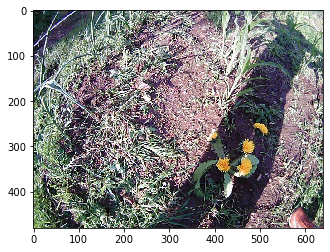

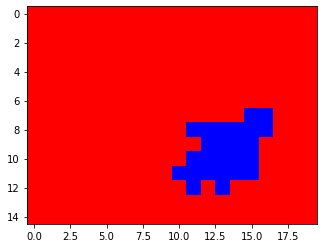

In [5]:
ishow(X[5,:,:,:])
ishow(y[5,:,:,:])

In [6]:
TRAINING_SHARE = 0.8
SEED = 3141

np.random.seed(SEED)
mask_train = np.random.rand(X.shape[0]) <= TRAINING_SHARE
mask_val = np.logical_not(mask_train)

In [7]:
assert np.max(mask_train + mask_val) == 1
assert np.max(mask_train * mask_val) == 0

In [8]:
X_train = X[mask_train,:,:,:]
y_train = y[mask_train,:,:,:]
X_val = X[mask_val,:,:,:]
y_val = y[mask_val,:,:,:]

In [9]:
X_train.shape, y_train.shape, X_val.shape, y_val.shape

((831, 480, 640, 3), (831, 15, 20, 3), (223, 480, 640, 3), (223, 15, 20, 3))

In [10]:
model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(filters=64, kernel_size=3, strides=1, padding='same', activation='relu'),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv2D(filters=64, kernel_size=3, strides=2, padding='same', activation='relu'),
    #tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Dropout(0.2),
    #ResnetIdentityBlock(1, [64,64,64]),
    tf.keras.layers.MaxPool2D(),
    tf.keras.layers.Conv2D(filters=48, kernel_size=3, strides=1, padding='same', activation='relu'),
    tf.keras.layers.Conv2D(filters=48, kernel_size=3,  strides=1, dilation_rate=(2, 2), padding='same', activation='relu'),
    #ParallelLayer(),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Conv2D(filters=32, kernel_size=1, strides=1, padding='same', activation='relu'),
    #tf.keras.layers.BatchNormalization(),
    tf.keras.layers.Dropout(0.2),
    tf.keras.layers.Conv2D(filters=16, kernel_size=3, strides=2, padding='same', activation='relu'),
    #tf.keras.layers.BatchNormalization(),
    tf.keras.layers.MaxPool2D(),
    tf.keras.layers.Conv2D(filters=3, kernel_size=3, strides=2, padding='same', activation='relu'),
    tf.keras.layers.Softmax()
])

In [11]:
shape = list(X.shape)
shape[0] = None
shape

[None, 480, 640, 3]

In [12]:
model.build(input_shape=shape)
model.compile(optimizer=tf.keras.optimizers.Adam(), loss=tf.keras.losses.CategoricalCrossentropy())
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 480, 640, 64)      1792      
_________________________________________________________________
batch_normalization (BatchNo (None, 480, 640, 64)      256       
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 240, 320, 64)      36928     
_________________________________________________________________
dropout (Dropout)            (None, 240, 320, 64)      0         
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 120, 160, 64)      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 120, 160, 48)      27696     
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 120, 160, 48)      2

In [13]:
NUM_EPOCHS = 15

In [14]:
for epoch in range(NUM_EPOCHS):
    step_horizontal = 1
    step_vertical = 1
    gc.collect()
    if epoch % 2 == 0:
        print("flip horz")
        step_horizontal = -1
    if epoch % 3 == 0:
        print("flip vert")
        step_vertical = -1
    if epoch % 5 == 0:
        print("add noise")
        noise = np.random.normal(scale=0.2, size=X_train.shape[0]).reshape((-1,1,1,1))
    else:
        noise = np.zeros(X_train.shape[0]).reshape((-1,1,1,1))
    model.fit(
        X_train[:,::step_horizontal,::step_vertical,:] + noise,
        y_train[:,::step_horizontal,::step_vertical,:],
        epochs=epoch+1,
        batch_size=2,
        verbose=1,
        validation_data=(X_val, y_val),
        validation_steps=1,
        initial_epoch=epoch
        #steps_per_epoch=X_train.shape[0]//2
        #class_weight={0:1.0, 1:1.0, 2:10.0}
    )

flip horz
flip vert
add noise
416/416 [==============================] - 25s 53ms/step - loss: 0.3169 - val_loss: 0.2618
Epoch 2/2
416/416 [==============================] - 22s 52ms/step - loss: 0.2398 - val_loss: 0.1888
flip horz
Epoch 3/3
416/416 [==============================] - 22s 52ms/step - loss: 0.1912 - val_loss: 0.1742
flip vert
Epoch 4/4
416/416 [==============================] - 22s 52ms/step - loss: 0.1831 - val_loss: 0.1762
flip horz
Epoch 5/5
416/416 [==============================] - 22s 52ms/step - loss: 0.1714 - val_loss: 0.1710
add noise
Epoch 6/6
416/416 [==============================] - 22s 52ms/step - loss: 0.1802 - val_loss: 0.1200
flip horz
flip vert
Epoch 7/7
416/416 [==============================] - 22s 53ms/step - loss: 0.1635 - val_loss: 0.1517
Epoch 8/8
416/416 [==============================] - 22s 52ms/step - loss: 0.1553 - val_loss: 0.1766
flip horz
Epoch 9/9
416/416 [==============================] - 22s 52ms/step - loss: 0.1540 - val_loss: 0.2210
f

In [15]:
y_val_pred = model.predict(X_val, batch_size=2)

In [ ]:
IMAGE_RESOLUTION = (640, 480)
bar = np.zeros((IMAGE_RESOLUTION[1],1,3))

for idx in range(sum(mask_val)):
    y_val_idx = cv2.resize(y_val[idx,:,:,:], IMAGE_RESOLUTION, interpolation=cv2.INTER_NEAREST)
    y_val_pred_idx = cv2.resize(y_val_pred[idx,:,:,:], IMAGE_RESOLUTION, interpolation=cv2.INTER_NEAREST)
    vis = np.concatenate([X_val[idx,:,:,:],bar,y_val_pred_idx,bar,y_val_idx], axis=1)
    ishow(vis, figsize=(24,24))

In [17]:
converter = tf.lite.TFLiteConverter.from_keras_model(model)
converter.optimizations = [tf.lite.Optimize.DEFAULT]
converter.target_spec.supported_types = [tf.float16]

In [18]:
tflite_fp16_model = converter.convert()
tflite_model_fp16_file = "./models/danelion-v2-f16.tflite"
open(tflite_model_fp16_file, 'wb').write(tflite_fp16_model)

INFO:tensorflow:Assets written to: /tmp/tmpdp4ay4ju/assets


197744

In [71]:
y_train_pred = model.predict(X[mask_train,:,:,:], batch_size=2)

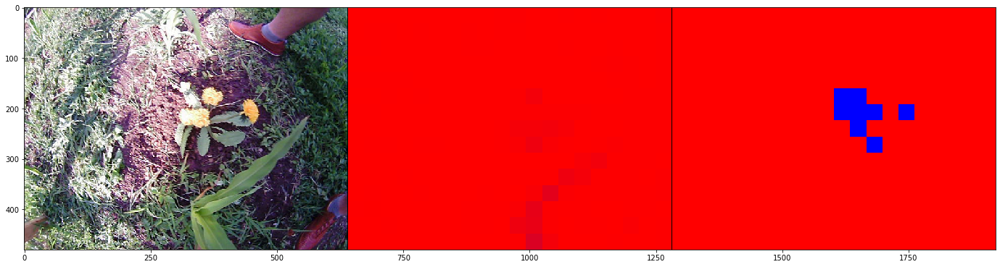

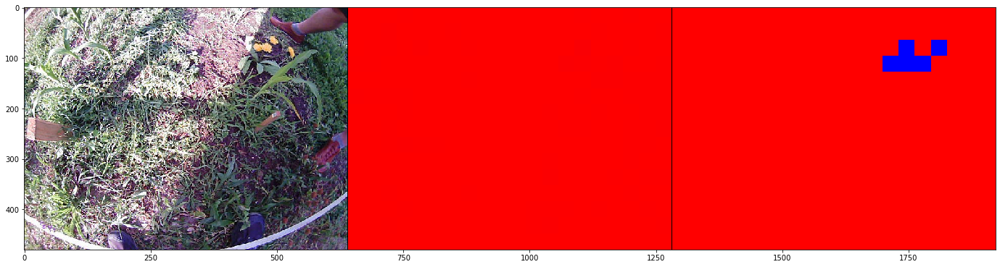

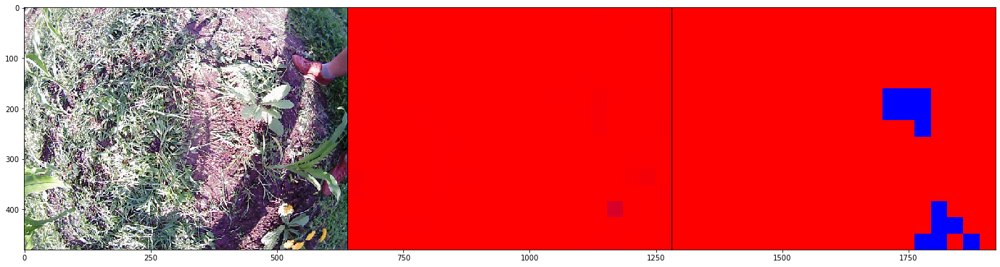

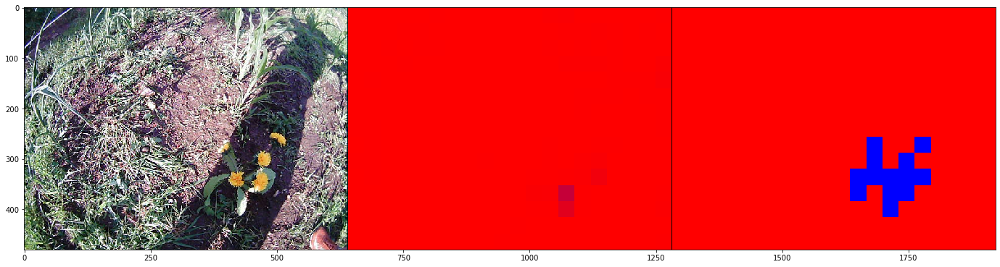

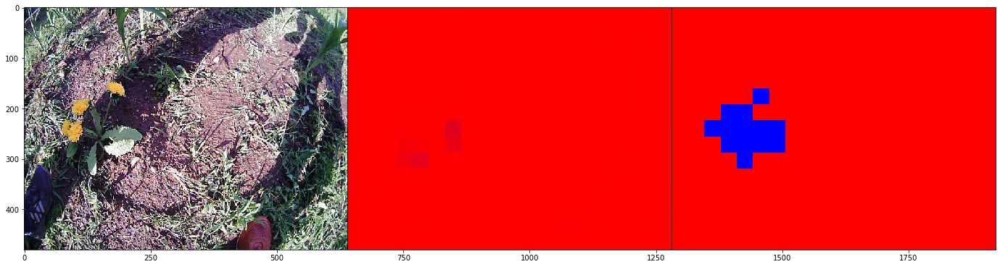

...

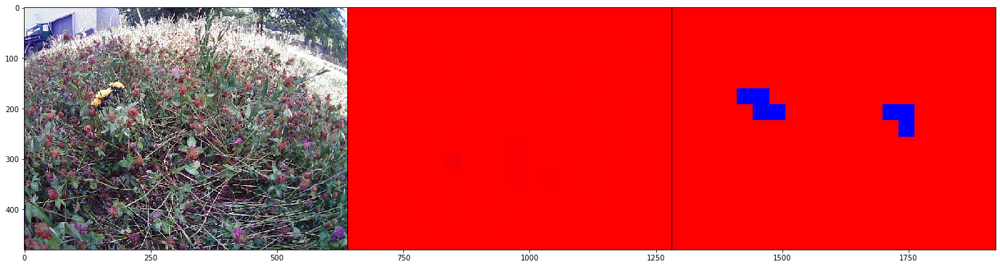

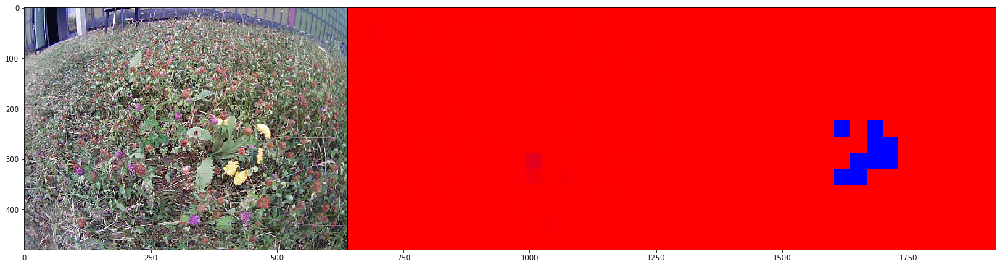

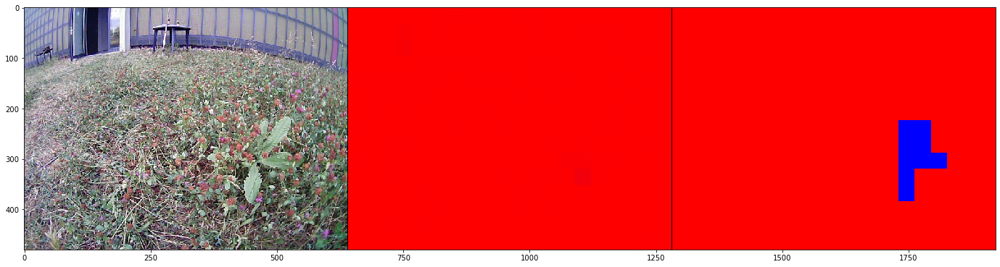

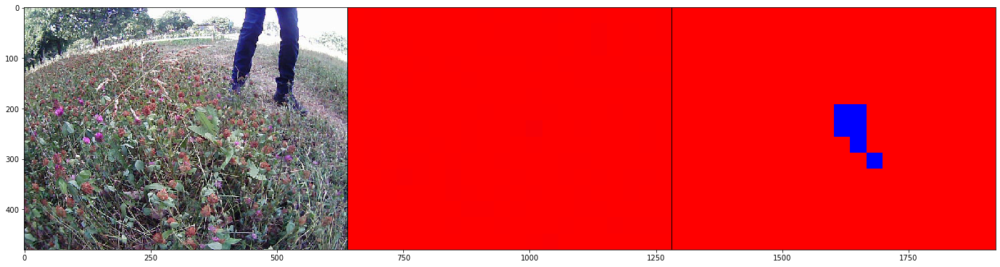

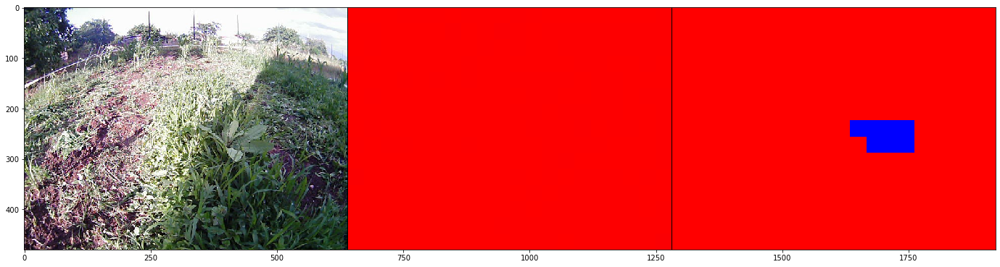

KeyboardInterrupt: 

In [61]:
bar = np.zeros((IMAGE_RESOLUTION[1],1,3))
for idx in range(sum(mask_train)):
    y_train_idx = cv2.resize(y_train[idx,:,:,:], IMAGE_RESOLUTION, interpolation=cv2.INTER_NEAREST)
    y_train_pred_idx = cv2.resize(y_train_pred[idx,:,:,:], IMAGE_RESOLUTION, interpolation=cv2.INTER_NEAREST)
    vis = np.concatenate([X_train[idx,:,:,:],bar,y_train_pred_idx,bar,y_train_idx], axis=1)
    ishow(vis, figsize=(24,24))